# Myeloma CAR-T

## Notebook setup

Load python packages and modules that are used across this notebook. For an introduction to python packages and modules, please see https://realpython.com/python-modules-packages/#python-packages.    

In [1]:
import scanpy as sc
import scanpy.external as sce
#import scvelo as scv
import numpy as np
import pandas as pd
import warnings, scipy.sparse as sp, matplotlib, matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.pyplot import rc_context
from collections import Counter
from pathlib import Path
from sklearn.metrics.pairwise import cosine_distances
#from mousipy import translate

import matplotlib.font_manager
import openpyxl
import pyreadr
#import rpy2
#from rpy2.robjects.packages import importr
#import rpy2.robjects as robjects
# import seaborn as sns
# import palantir
# import loompy
# import feather
# import re
# from scipy.sparse import csgraph

matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = 'Arial'
matplotlib.rc('font', size=14)
import matplotlib.lines as lines

sc.set_figure_params(dpi=80, dpi_save=300, color_map='Spectral_r', vector_friendly=True, transparent=True)
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

#scv.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True, format='pdf')

pd.set_option('display.max_rows', 200)

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/brandonng/opt/anaconda3

scanpy==1.9.3 anndata==0.8.0 umap==0.5.3 numpy==1.22.3 scipy==1.5.3 pandas==2.0.0 scikit-learn==1.2.2 statsmodels==0.13.5 python-igraph==0.10.4 pynndescent==0.5.10


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/umap/umap_.py:660: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()


In [2]:
# import pkg_resources
# pkg_resources.require("numpy==1.23.5")
# import numpy

In [3]:
import muon as mu
import muon.prot as pt
sc.logging.print_header()

scanpy==1.9.3 anndata==0.8.0 umap==0.5.3 numpy==1.22.3 scipy==1.5.3 pandas==2.0.0 scikit-learn==1.2.2 statsmodels==0.13.5 python-igraph==0.10.4 pynndescent==0.5.10


In [4]:
# pip install scvelo==0.2.5

In [5]:
#import sys
#!{sys.executable} -m pip install scikit-learn==1.2.1

In [6]:
def observe_variance(anndata_object):
    fig = plt.figure(figsize=(10,5))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    # variance per principal component
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = anndata_object.uns['pca']['variance_ratio']
    ax1.scatter(x,y,s=4)
    ax1.set_xlabel('PC')
    ax1.set_ylabel('Fraction of variance explained\n')
    ax1.set_title('Fraction of variance explained per PC\n')
    # cumulative variance explained
    cml_var_explained = np.cumsum(anndata_object.uns['pca']['variance_ratio'])
    x = range(len(anndata_object.uns['pca']['variance_ratio']))
    y = cml_var_explained
    ax2.scatter(x,y,s=4)
    ax2.set_xlabel('PC')
    ax2.set_ylabel('Cumulative fraction of variance\nexplained')
    ax2.set_title('Cumulative fraction of variance\nexplained by PCs')
    fig.tight_layout()
    plot = plt.show
    return(plot)

In [7]:

#!{sys.executable} -m pip install xlsxwriter
#!{sys.executable} -m pip install rpy2
import xlsxwriter
import rpy2

In [8]:
import os

os.environ['R_HOME'] = '/Library/Frameworks/R.framework/Resources'

In [9]:
%load_ext rpy2.ipython

%R if (!require("pacman")) install.packages("pacman")
%R pacman::p_load(MAST, scales, data.table, openxlsx, ggplot2, ggpubr, RColorBrewer, dichromat, readxl, ggpubr, pheatmap, dplyr, arrow, feather, DelayedArray, HDF5Array, stringr, parallel)

Loading required package: pacman


1,1,1,...,1,1,1


`%matplotlib inline` is a magic command that renders the figures within the notebook. For more information regarding python's magic operators, see https://ipython.readthedocs.io/en/stable/interactive/magics.html.

In [10]:
%matplotlib inline 

To get you started in a visually pleasing way, here are some manually curated color palettes. Feel free to use the ones provided here, the python predefined ones here (https://matplotlib.org/stable/tutorials/colors/colormaps.html) or make up your own.

In [11]:
# divergent
user_defined_palette =  [ '#3283FE', '#16FF32', '#F6222E',  '#FEAF16', '#BDCDFF', '#3B00FB', '#1CFFCE', '#C075A6', '#F8A19F', '#B5EFB5', '#FBE426', '#C4451C', '#2ED9FF', '#c1c119', '#8b0000', '#FE00FA', '#1CBE4F', '#1C8356', '#0e452b', '#AA0DFE', '#B5EFB5', '#325A9B', '#90AD1C']
# gradient of one color
user_defined_cmap_markers = LinearSegmentedColormap.from_list('mycmap', ["#E6E6FF", "#CCCCFF", "#B2B2FF", "#9999FF",  "#6666FF",   "#3333FF", "#0000FF"])
# gradient of two colors
user_defined_cmap_degs = LinearSegmentedColormap.from_list('mycmap', ["#0000FF", "#3333FF", "#6666FF", "#9999FF", "#B2B2FF", "#CCCCFF", "#E6E6FF", "#E6FFE6", "#CCFFCC", "#B2FFB2", "#99FF99", "#66FF66", "#33FF33", "#00FF00"])

💡 **Hint:** Use the code below ONLY if you need to install extra packages

Return to the beginning of this notebook <a href='#contents'>here</a>.

<a id='QC'></a>

##  Perform quality control and clean-up samples

### Load cellranger files

Start by converting any cellranger's (https://support.10xgenomics.com/single-cell-gene-expression/software/pipelines/latest/output/overview) Hierarchical Data Format 5 (H5 or h5) files into a scRNA-seq friendly python object called an anndata object. This object can store different types of information under its multiple compartments. For a more detailed explanation, see https://anndata.readthedocs.io/en/latest/anndata.AnnData.html#anndata.AnnData. 

The example below uses Peripheral Blood Mononuclear Cells (PBMCs) datasets from the 10x Genomics public repository, processed with cellranger v2 [⬇️](https://cf.10xgenomics.com/samples/cell-exp/3.0.0/pbmc_1k_v2/pbmc_1k_v2_filtered_feature_bc_matrix.h5) and v3 [⬇️](https://cf.10xgenomics.com/samples/cell-exp/3.0.0/pbmc_1k_v3/pbmc_1k_v3_filtered_feature_bc_matrix.h5) to perform a mock analysis).

✍️ Provide the path to your cellranger's `filtered_feature_bc.h5` files in the `tenexdir` row below. The code will search that directory and store all h5 files in a python [list](https://realpython.com/python-lists-tuples/), names here `adatas_list` as it contains multiple adata (short for anndata) objects.

In [11]:
#for MBP /Users/brandonng/Google Drive/Weill Cornell/LAB/writing:reviewing/myeloma paper/folder containing all data from Mac pro/experiments and data/single cell/2022-12-21 APRIL BB IL-18 single cell experiment/BrandonNg_MM_IL-18_singlecell.ipynb
# for Mac Pro lab /Users/ngb/Library/CloudStorage/GoogleDrive-ngbrandond@gmail.com/My Drive/Weill Cornell/LAB/writing:reviewing/myeloma paper/folder containing all data from Mac pro/experiments and data/single cell/2022-12-21 APRIL BB IL-18 single cell experiment/data/

In [15]:
adatas_list=[]

tenexdir = '/Users/brandonng/Google Drive/Weill Cornell/LAB/folder containing all data from Mac pro/experiments and data/single cell/2022-12-21 APRIL BB IL-18 single cell experiment/data'
h5_path = Path(tenexdir).glob('**/**/*.h5')

# a for loop to read and store all .h5 files under the tenexdir path
for path in h5_path:
    tmp_adata = sc.read_10x_h5(path)
    tmp_adata.var_names_make_unique()
    print(tmp_adata.shape) # check the number of cells and genes in each sample
    adatas_list.append(tmp_adata)

reading /Users/brandonng/Google Drive/Weill Cornell/LAB/folder containing all data from Mac pro/experiments and data/single cell/2022-12-21 APRIL BB IL-18 single cell experiment/data/internal/10xGenomics/Chromium/BN-2099_group1/cr-gex-results/filtered_feature_bc_matrix.h5
 (0:00:03)


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(21243, 32285)
reading /Users/brandonng/Google Drive/Weill Cornell/LAB/folder containing all data from Mac pro/experiments and data/single cell/2022-12-21 APRIL BB IL-18 single cell experiment/data/internal/10xGenomics/Chromium/BN-2099_group2/cr-gex-results/filtered_feature_bc_matrix.h5
 (0:00:03)


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(21153, 32285)


✍️ The next command will take as input the various anndata objects that have been created above, concatenate them and create a metadata field using the `label` field. Use then the `keys` field to annotate each sample accordingly. The order of the samples is defined by the order that the h5 files are stored in the function above.

In [16]:
adata = sc.concat(
    adatas_list,
    join='outer', 
    label = 'sample', 
    keys = ['APRIL-BB','APRIL-BB-IL18'],
    index_unique = '@'
)

In [17]:
adata.shape

(42396, 32285)

In [18]:
adata.raw = adata # keep a copy of the raw adata 
np.random.seed(42) 
index_list = np.arange(adata.shape[0]) # randomize the order of cells for plotting
np.random.shuffle(index_list)
adata = adata[index_list]

Once you execute either of the input commands above, you should be able to access:
- gene names: type `adata.var` + click `Run`
- cell index and other annotation: type `adata.obs` + click `Run`
- total number of cells (x, ) and genes ( ,y): type `adata.shape` + click `Run`

❗ The latter one is a good sanity check especially after filtering steps to make sure the filters have been applied properly. 

In [19]:
adata.shape

(42396, 32285)

### Calculate quality control metrics and perform standard clean-up

We will now calculate some standard quality control (QC) metrics using the `calculate_qc_metrics` function that is provided by scanpy. These metrics include total counts, total number of genes, ribosomal, mitochondrial and hemoglobin fractions on a per cell basis. Summarized violin plots of these metrics can be also visualized below on a per sample basis.

In [20]:
sc.pp.calculate_qc_metrics(adata, inplace=True)

#store unfiltered/unprocessed data into new fields prior to downstream analysis
adata.obs['original_total_counts'] = adata.obs['total_counts']
adata.obs['log10_original_total_counts'] = np.log10(adata.obs['original_total_counts'])

# select mitochondrial, ribosomal and hemoglobin genes (case sensitive)
adata.var['mt'] = adata.var_names.str.startswith(('MT-', 'mt-'))
adata.var['ribo'] = adata.var_names.str.startswith(('RPS','RPL', 'Rps', 'Rpl'))
adata.var['hb'] = adata.var_names.str.startswith(('HB', 'Hb'))

# for each cell compute fraction of counts in mitochondrial, ribosomal and hemoglobin genes vs. all genes 
adata.obs['mito_frac'] = np.sum(adata[:,adata.var['mt']==True].X, axis=1) / np.sum(adata.X, axis=1)
adata.obs['ribo_frac'] = np.sum(adata[:,adata.var['ribo']==True].X, axis=1) / np.sum(adata.X, axis=1)
adata.obs['hb_frac'] = np.sum(adata[:,adata.var['hb']==True].X, axis=1) / np.sum(adata.X, axis=1)

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


In [21]:
adata

AnnData object with n_obs × n_vars = 42396 × 32285
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'original_total_counts', 'log10_original_total_counts', 'mito_frac', 'ribo_frac', 'hb_frac'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'ribo', 'hb'

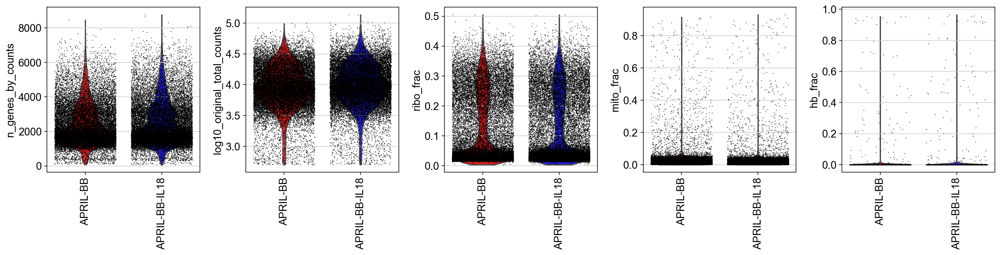

In [22]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'log10_original_total_counts', 'ribo_frac', 'mito_frac', 'hb_frac'],  
             palette=['Red', 'Blue'],  jitter=0.4, groupby = 'sample', rotation= 90,
#             save="QC_metrics_all_cells.pdf"
            )

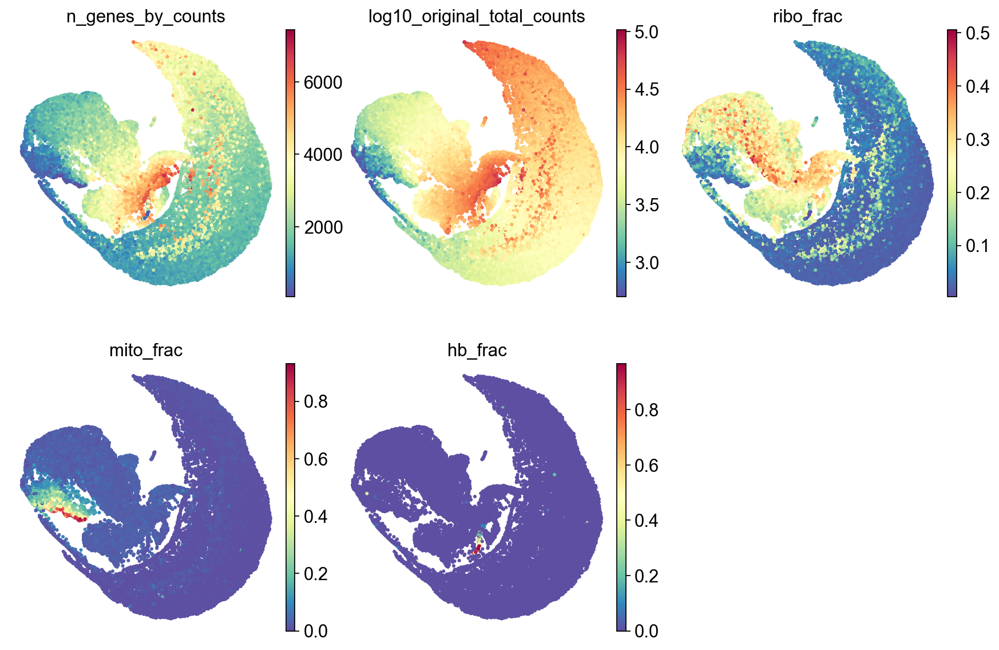

In [47]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(adata, 
    color=['n_genes_by_counts', 'log10_original_total_counts', 'ribo_frac', 'mito_frac', 'hb_frac'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=3,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=30,
    frameon=False,
    add_outline=False,
    sort_order = False,
#            save="_QC_all_cells_2.pdf"
)

In [20]:
# Integration of HTO

In [28]:
adata.shape

(42396, 32285)

In [29]:
# add hashtag annotation
hashtags_APRIL_BB = sc.read_h5ad("../2022-12-21 APRIL BB IL-18 single cell experiment/data/internal/10xGenomics/Chromium/BN-2099_group1_HTO/Hashtag-results/BN-2099_group1.h5ad")
hashtags_APRIL_BB_IL18 = sc.read_h5ad("../2022-12-21 APRIL BB IL-18 single cell experiment/data/internal/10xGenomics/Chromium/BN-2099_group2_HTO/Hashtag-results/BN-2099_group2.h5ad")

In [30]:
hashtags_APRIL_BB.obs.index = hashtags_APRIL_BB.obs['barcode_sequence']
hashtags_APRIL_BB_IL18.obs.index = hashtags_APRIL_BB_IL18.obs['barcode_sequence']

In [31]:
hashtags_APRIL_BB.obs.index.name = ''
hashtags_APRIL_BB_IL18.obs.index.name = ''

In [32]:
hashtags = sc.concat(
    [hashtags_APRIL_BB,hashtags_APRIL_BB_IL18], # the asterisk unpacks the list containing your AnnData objects. 
    join='outer', 
    label = 'status', 
    keys = ['APRIL-BB', 'APRIL-BB-IL18'], # or use your sample_names list (as used above) here. 
    # Make sure the order of the batch categories matches that of the AnnData objects 
    index_unique = '-1@'
)

In [33]:
adata = adata[hashtags.obs.index]

In [34]:
adata.obs['hash_id']=hashtags.obs['hash_id']

/var/folders/mz/cx_t4jz14rb9bdh4tpz0lhzc0000gn/T/ipykernel_71058/2068867089.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['hash_id']=hashtags.obs['hash_id']


#### Identify doublets

We will use scanpy's implementation (`scanpy.external.pp.scrublet` function) of scrublet (https://github.com/swolock/scrublet) to predict doublets. This command will use the default parameters of `scanpy.external.pp.scrublet`, however, if you are feeling brave and disagree with the predicted parameters you can use this scrublet's example notebook (https://github.com/swolock/scrublet/blob/master/examples/scrublet_basics.ipynb) to alter them to your preferred ones.

✍️ Because automatic threshold was not optimal, here we adjusted the threshold manually to make it more stringent.

In [43]:
sc.external.pp.scrublet(adata, threshold=0.3, random_state=42) # choose threshold manually

Running Scrublet
filtered out 11821 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Detected doublet rate = 1.2%
Estimated detectable doublet fraction = 12.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 9.7%
    Scrublet finished (0:01:45)


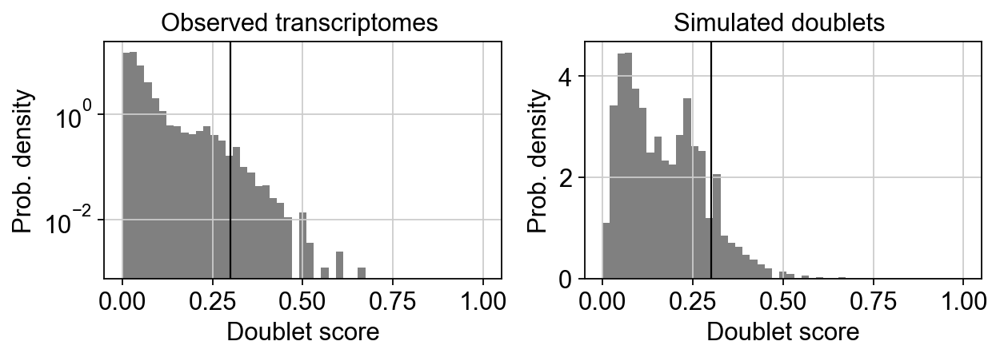

In [31]:
sc.external.pl.scrublet_score_distribution(adata) # inspect manual threshold

#### Remove not expressed genes

✍️ We will remove genes that are not expressed in any cells across our samples, as these genes will not contribute to any biological insight, but rather may affect downstream analysis speed. This step can become more stringent by providing a higher number of cells in the `min_cells` field.

In [32]:
sc.pp.filter_genes(adata, min_cells=1) # remove columns with all 0s

filtered out 9217 genes that are detected in less than 1 cells


#### Remove ribosomal and hemoglobin genes

Ribosomal and hemoglobin genes constitute a high percentage of the total read counts, and they can affect downstream analysis and interpretation of our data, therefore, here we remove these genes before further processing.

In [33]:
adata = adata[:,adata.var['ribo']==False]
adata.shape # check number of genes after ribosomal gene removal

(40383, 22968)

In [34]:
adata = adata[:,adata.var['hb']==False]
adata.shape # check number of genes after hemoglobin gene removal

(40383, 22956)

#### Normalize each cell's library size

Next, we will normalize each cell to a total library size of 10,000 reads. The `adata.X` field will be updated automatically with the normalized counts.

In [35]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=10**4)

normalizing by total count per cell


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:524: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_n_counts] = counts_per_cell


    finished (0:00:15): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


❗ Raw data can be recovered via the `adata.raw` field.

#### Log-transform counts

We will also *log*-transform the gene counts here using scanpy's `sc.pp.log1p` function. This function uses the `log(X+1)` formula, in which *log* denotes the natural logarithm.

In [36]:
sc.pp.log1p(adata)

In [37]:
adata.shape

(40383, 22956)

### Select a subset of principal components 

Prior to plotting our data in a 2-dimensional space (in this case using scanpy's `sc.pl.umap` function), we need to select a small number of principal components to reduce the noise of this multitude of data and as well increase the execution speed.

For that, we will first select a large number of principal components and visualize the percentage of variance explained by each component.

*For fun, here and in all the cases that we need to set a seed, we will use the **number 42**, the answer to the Ultimate Question of Life, the Universe, and Everything.*

In [202]:
rng = np.random.RandomState(42) # set seed 
sc.tl.pca(adata, n_comps=200, svd_solver='arpack', random_state=rng)

computing PCA
    with n_comps=200
    finished (0:03:45)


<function matplotlib.pyplot.show(close=None, block=None)>

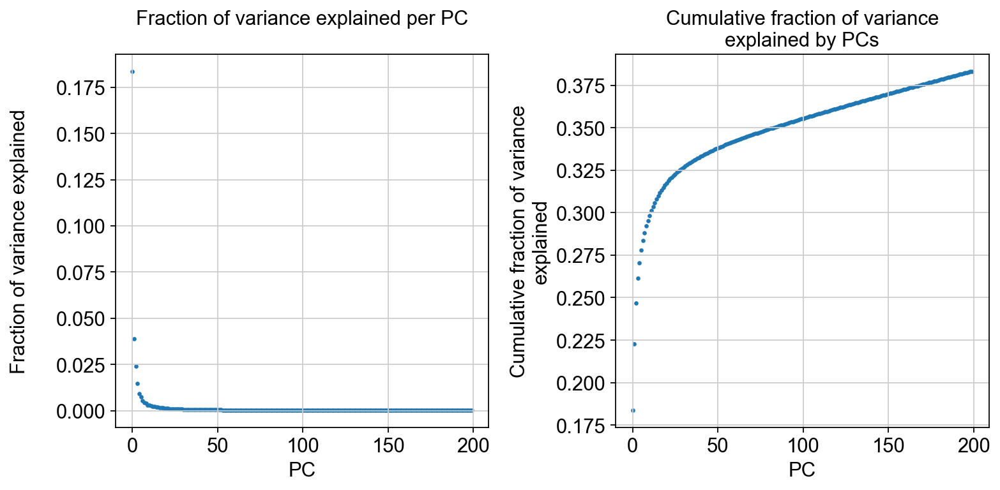

In [203]:
observe_variance(adata)

❗ We want to include all the principal components before the 'knee point' (the point where the fitted curve would change slope the most), because these likely represent important sources of variance in our data. To try and avoid eliminating any relevant but small sources of variance, we will choose a number of PCs slightly to the right of the knee point. 

✍️ Replace the number in the `n_comps` field with your principal components selection.

In [37]:
rng = np.random.RandomState(42) # set seed 
sc.tl.pca(adata, n_comps=60,  svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=15, random_state=42) # set seed
sc.tl.umap(adata)

computing PCA
    with n_comps=60
    finished (0:00:47)
computing neighbors
    using 'X_pca' with n_pcs = 60
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:33)


In [1]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color=['sample'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=5,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(


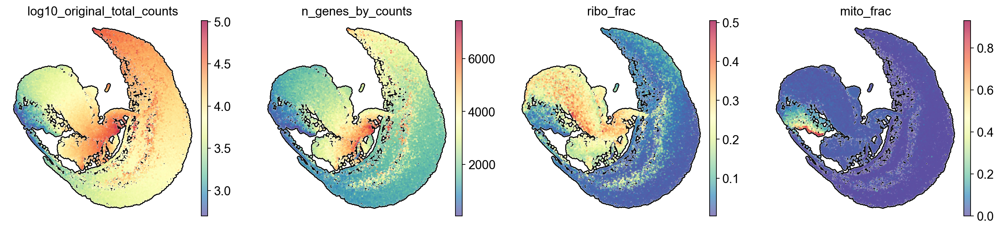

In [39]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color=['log10_original_total_counts', 'n_genes_by_counts','ribo_frac', 'mito_frac'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=5,
    wspace = 0.2,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

❗ **Does your data look well distinguished?** If yes, move ahead. If no, maybe try to increase (or decrease) the number of principal components you used, and rerun the last bits of code.

### Run unsupervised clustering analysis with leiden

Next, we perform leiden clustering analysis using consecutive resolution parameters and visualize the resulting clusters in the respective generated UMAPs. We can then visually select an optimal number of clusters that better identify contaminant populations and also clusters of cells that have a combination of "bad" quality measures. Here, we aim to remove as cleanly as possible bad quality cells and cell contaminants that we don't want carry in our downstream analysis.   

In [78]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(adata, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

running Leiden clustering
    finished: found 8 clusters and added
    'leiden_0.1', the cluster labels (adata.obs, categorical) (0:00:06)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:09)
running Leiden clustering
    finished: found 14 clusters and added
    'leiden_0.3', the cluster labels (adata.obs, categorical) (0:00:07)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:08)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:10)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:11)
running Leiden clustering
    finished: found 26 clusters and added
    'leiden_0.7', the cluster labels (adata.obs, categorical) (0:00:13)
running Leiden cluste

We can visualize the clustering to see which clusters match with the cells that we would like to filter out. Inspect the list of QC metrics and canonical markers to make your choice.

In [2]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

❗ Store total number of cells prior to any filtering to use for a per sample summary cells that did not pass QC visual

In [25]:
adata_memo = adata

### Filter out bad quality cells and other cell contaminants by cluster

Now inspect the QC metrics for each of the clusters and choose to remove any clusters that may have a combination of bad quality metrics.

✍️ Choose which clusters you want to remove, and add them to the list clusters_to_remove below.

In [82]:
clusters_to_remove = ['4']
cluster_filter = [x not in clusters_to_remove for x in adata.obs['leiden_0.1']]
print('Total number of cells pre-filtering: ' + str(adata.shape[0]))
print('Number of cells to keep after filtering: ' + str(sum(cluster_filter)))
adata_filtered = adata[cluster_filter]

Total number of cells pre-filtering: 40383
Number of cells to keep after filtering: 38776


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


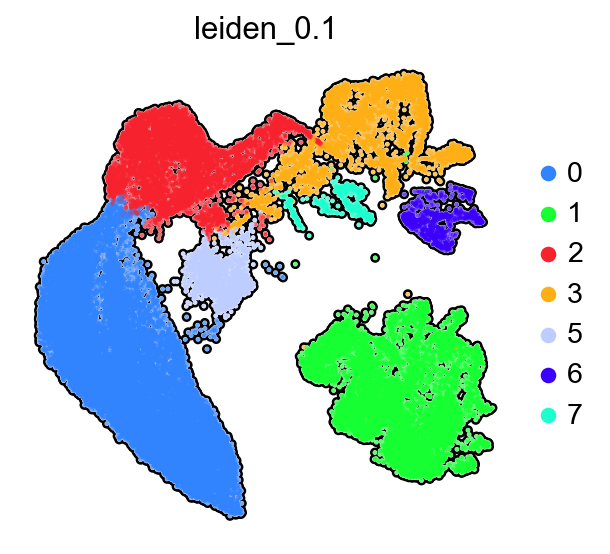

In [83]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata_filtered, 
    color=['leiden_0.1'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

❗ **Were the correct clusters removed?** If the bad quality cells and doublets are removed, run the next line to store the result in your adata object and continue with the analysis.

In [84]:
adata = adata_filtered

In [85]:
adata.shape

(38776, 22956)

### Filter out doublets

This would be also a good spot to remove the doublets that we have identified above. We first inspect where the predicted doublets lie on the UMAP and then we proceed to remove them.

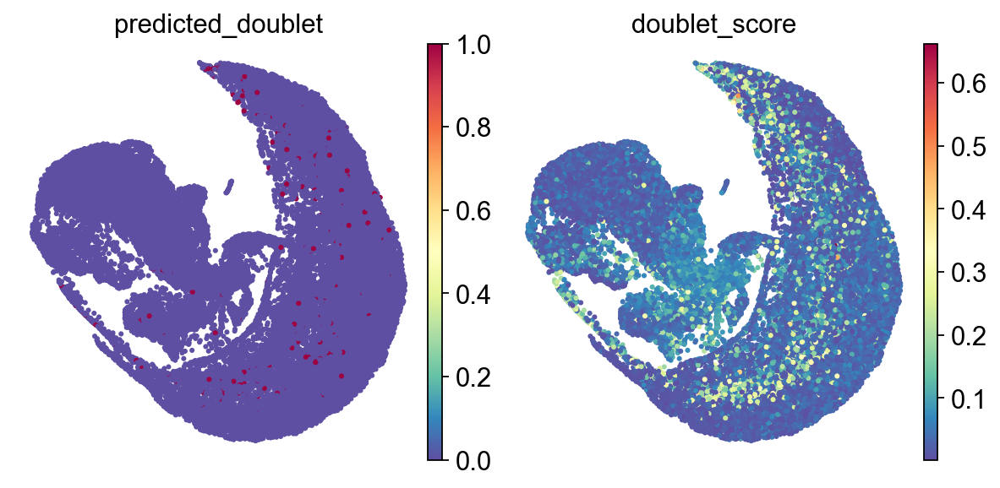

In [49]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    adata, 
    color=['predicted_doublet', 'doublet_score'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=30,
    frameon=False,
    add_outline=False,
    sort_order = False,
    save="_QC_doublet2.pdf"
)

In [87]:
# sc.pl.histogram(adata, "doublet_score")

In [88]:
adata = adata[adata.obs['predicted_doublet'] == False] # remove cells annotated as doublets

In [1]:
sc.pl.umap(
    adata, 
    color=['predicted_doublet', 'doublet_score'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=False,
    sort_order = False
)

Let's now check the exact number of doublet cells that were removed from the dataset.

In [90]:
adata.shape

(38318, 22956)

In [91]:
# removing doublets that are observed in hashtag data

In [92]:
adata = adata[adata.obs['hash_id'] != 'Doublet']

In [2]:
sc.pl.umap(
    adata, 
    color=['hash_id'], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

### Inspect the data after removal of "unwanted" cells

Here, we create annotation for the cells that have been removed or kept to visualize them in a UMAP and a stacked barplot format.

In [26]:
adata.obs['keep_cell'] = '0.yes'
keep_cells = pd.concat([adata.obs['keep_cell']])
adata_memo.obs['keep_cell'] = '1.no'

In [27]:
adata_memo.obs['keep_cell'][adata_memo.obs.index.isin(keep_cells.index) == True] = '0.yes'

/var/folders/mz/cx_t4jz14rb9bdh4tpz0lhzc0000gn/T/ipykernel_67096/3128002269.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata_memo.obs['keep_cell'][adata_memo.obs.index.isin(keep_cells.index) == True] = '0.yes'


In [3]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)

sc.pl.umap(
    adata_memo, 
    color=['keep_cell', 'n_genes_by_counts', 'log10_original_total_counts', 'ribo_frac', 'mito_frac', 'hb_frac', 'doublet_score'], 
    palette=['blue',  '#d3d3d3'],  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=3,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [30]:
crosstb = pd.crosstab(adata_memo.obs['sample'], adata_memo.obs['keep_cell'])

NameError: name 'adata_memo' is not defined

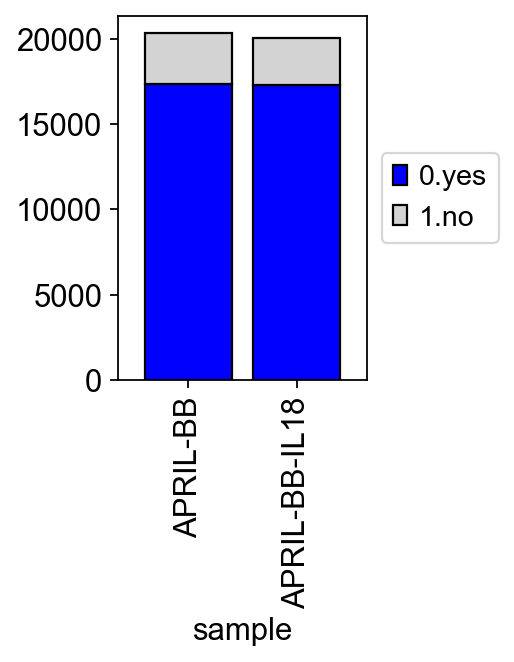

In [98]:
with rc_context({'figure.figsize': (2, 3)}):
    ax = crosstb.plot(kind="bar", stacked=True, edgecolor = "black", width=0.8,  color=['blue', '#d3d3d3'])
#     ax.grid(False) 
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    # to save plot unhash the line bellow
    plt.savefig('barplot_keepcells.pdf')

**Inspect QC generic metrics**

Replotting the summarized violin plots with the quality metrics calculated in `section 1.2` after removal of "unwanted" cells.

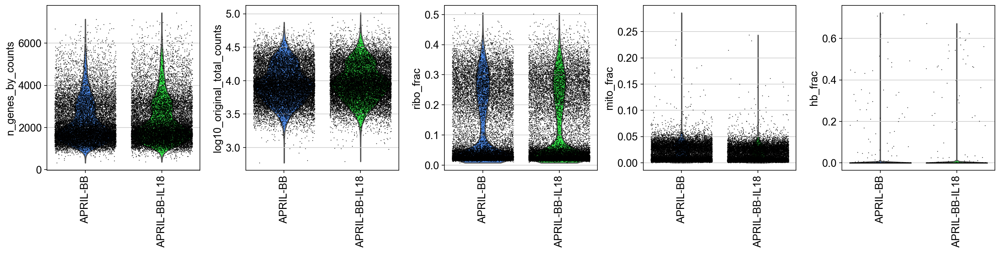

In [99]:
sc.pl.violin(adata, ['n_genes_by_counts', 'log10_original_total_counts', 'ribo_frac', 'mito_frac', 'hb_frac'],  
             palette=user_defined_palette,  jitter=0.4, groupby = 'sample', rotation= 90)

### Reanalyze the data after removal of "unwanted" cells

Once we have removed all "unwanted" cells, we need to reanalyze our data in a similar way to sections 1.3 and 1.4 above. 

In [106]:
rng = np.random.RandomState(42)
adata = sc.tl.pca(adata, n_comps=200, copy = True, svd_solver='arpack', random_state=rng)

computing PCA
    with n_comps=200
    finished (0:08:27)


<function matplotlib.pyplot.show(close=None, block=None)>

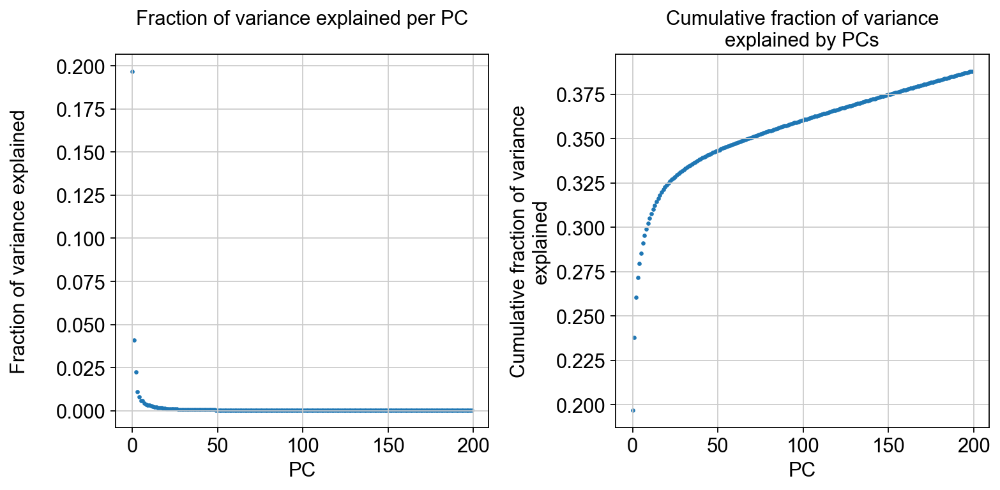

In [107]:
observe_variance(adata)

✍️ Remember to choose here a different number of principal components based on the re-analysis.

In [55]:
rng = np.random.RandomState(42) # use seed
sc.tl.pca(adata, n_comps=55, svd_solver='arpack', random_state=rng, use_highly_variable=False)
sc.pp.neighbors(adata, n_neighbors=15)
sc.tl.umap(adata)

computing PCA
    with n_comps=55
    finished (0:00:38)
computing neighbors
    using 'X_pca' with n_pcs = 55
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:18)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:23)


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


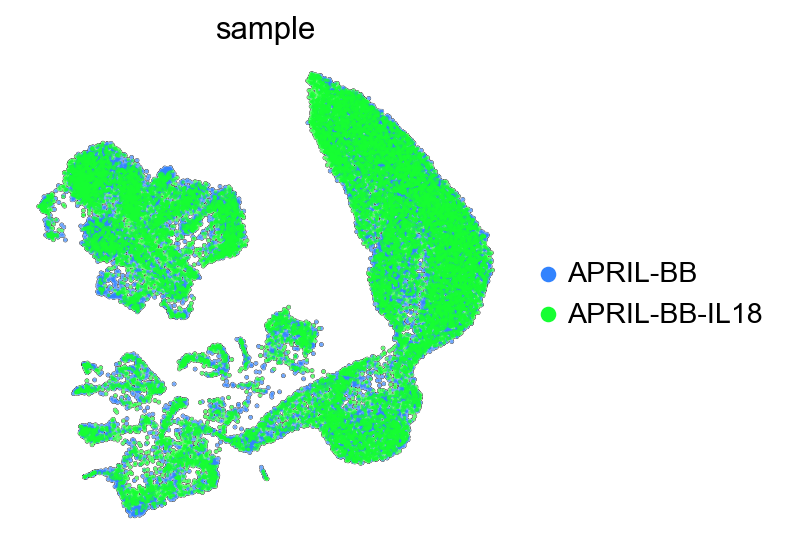

In [56]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color='sample', 
    use_raw=False,
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    ncols=5,
    wspace = 0.1,
    outline_width=[0.1, 0.05],
    size=10,
    frameon=False,
    add_outline=True,
    sort_order = False,
#         save="_adata_leiden_0_8.jpeg"
)

As previously, we perform leiden clustering analysis using consecutive resolution parameters and visualize the resulting clusters in the respective generated UMAPs. Here, we opt to select the number of clusters that better previously known populations (based on the expression of canonical markers), and also *de-novo* populations of cells that look well separated in the UMAP representation.

You are done! Just save you anndata object to come back to it later. Make sure your path ends with the desired filename including the .h5ad file extension. You can now come back to this dataset at anytime.

Return to the beginning of this notebook <a href='#contents'>here</a>.

<a id='phase'></a>

<a id='harmony'></a>

## Correct for batch effects with harmony

When ispecting the annotated by sample UMAP above, it is likely that samples from different experiments do not properly overlap, despite having shared populations, due to small but consistent technical effects (batches) across each dataset that influence their projection. We can initially attempt to correct for this by choosing only highly variable genes (hvgs) when running scanpy's `sc.tl.pca` function. This will create the UMAP based on the biggest differences of the existing populations and may salvage the technical noise that is more apparent when running the  analysis across all genes.

In [16]:
sc.pp.highly_variable_genes(adata, n_top_genes=3000, n_bins=20, flavor='seurat_v3',  inplace=True)

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:208: RuntimeWarning: invalid value encountered in log
  dispersion = np.log(dispersion)


    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


As above, observe and choose an optimal number of components based on the "knee point" of the curve below.

In [103]:
rng = np.random.RandomState(42)
sc.tl.pca(adata, n_comps=200, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=200
    finished (0:00:12)


<function matplotlib.pyplot.show(close=None, block=None)>

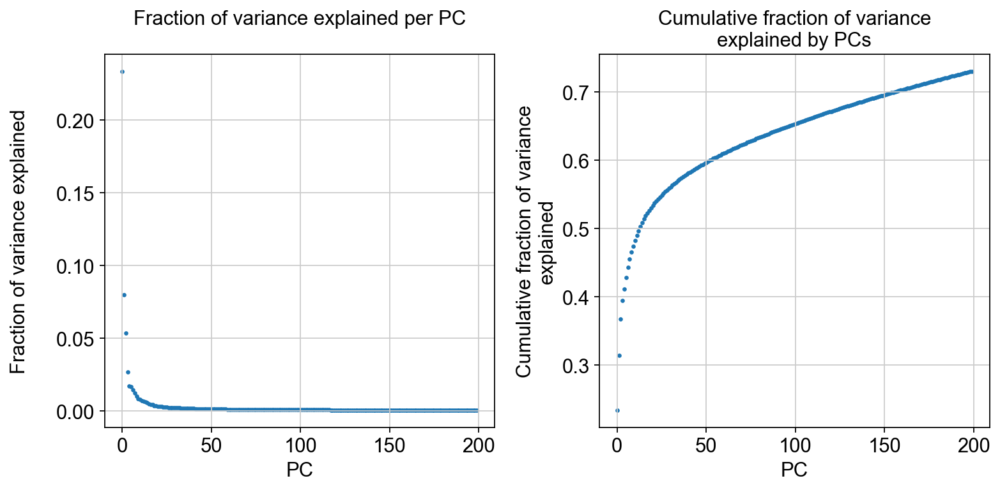

In [104]:
observe_variance(adata)

In [57]:
rng = np.random.RandomState(42)
sc.tl.pca(adata, n_comps=60, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=60
    finished (0:00:09)


### hvgs without batch effect correction

In [110]:
sc.pp.neighbors(adata, n_neighbors=15, use_rep='X_pca')
sc.tl.umap(adata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:27)


In [42]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:27)


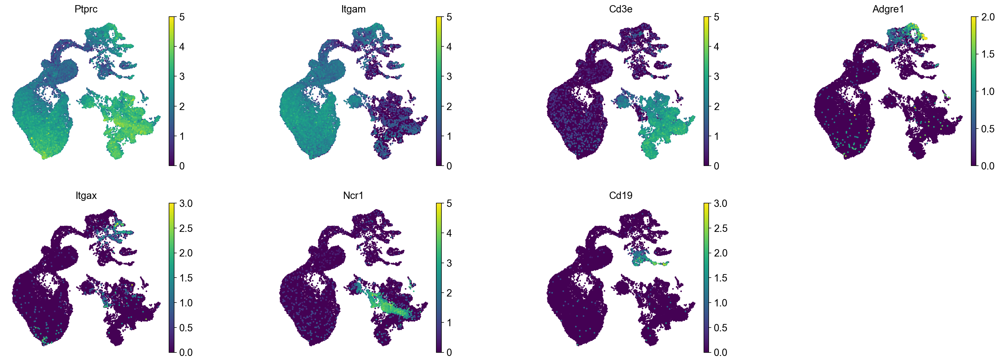

In [45]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(adata,
               color=['Ptprc', 'Itgam', 'Cd3e',  'Adgre1', 'Itgax', 'Ncr1', 'Cd19'],
               use_raw=False,
               frameon=False, 
               color_map='viridis',
               size=20,
               add_outline=False,
               wspace = 0.5,
               ncols = 4,
           vmax=[5,5,5,2,3,5,3],
#            save="_lineage_genes_RNA.pdf"
              )

In [15]:
path_to_h5ad = '/Users/brandonng/Google Drive/Weill Cornell/LAB/folder containing all data from Mac pro/experiments and data/single cell/2022-12-21 APRIL BB IL-18 single cell experiment/20230508_MM_IL-18_singlecell.h5ad'


In [16]:
# adata.write(path_to_h5ad)

In [17]:
# code to read back your saved h5ad object
adata = sc.read_h5ad(path_to_h5ad)
adata.uns['log1p']["base"] = None

In [18]:
adata

AnnData object with n_obs × n_vars = 34628 × 22956
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'original_total_counts', 'log10_original_total_counts', 'mito_frac', 'ribo_frac', 'hb_frac', 'hash_id', 'doublet_score', 'predicted_doublet', 'n_counts', 'leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0', 'keep_cell'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'ribo', 'hb', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hash_id_colors', 'hvg', 'leiden', 'leiden_0.1_colors', 'leiden_0.2_colors', 'leiden_0.3_colors', 'leiden_0.4_colors', 'leiden_0.5_colors', 'leiden_0.6_colors', 'leiden_0.7_colors', 'l

In [22]:
#make adata objects for each biological grou (APRIL_BB & APRIL_BB_IL18)
adata_APRIL_BB = adata[adata.obs['sample']=='APRIL-BB']
adata_APRIL_BB_IL18 = adata[adata.obs['sample']=='APRIL-BB-IL18']

In [76]:
rng = np.random.RandomState(42)
sc.tl.pca(adata, n_comps=60, svd_solver='arpack', random_state=rng, use_highly_variable=True)

computing PCA
    on highly variable genes
    with n_comps=60
    finished (0:00:03)


### Rerun leiden clustering

Once we have updated the pca components we use to compute the UMAP, we need to rerun leiden clustering analysis using consecutive resolution parameters and visualize the resulting clusters in the respective generated UMAPs to choose an appropriate UMAP.

In [15]:
for resolution_parameter in [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]:
    sc.tl.leiden(adata, resolution=resolution_parameter, random_state=42, 
                        key_added='leiden_'+str(resolution_parameter))

running Leiden clustering
    finished: found 6 clusters and added
    'leiden_0.1', the cluster labels (adata.obs, categorical) (0:00:05)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden_0.2', the cluster labels (adata.obs, categorical) (0:00:06)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden_0.3', the cluster labels (adata.obs, categorical) (0:00:06)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:08)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden_0.5', the cluster labels (adata.obs, categorical) (0:00:06)
running Leiden clustering
    finished: found 22 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:10)
running Leiden clustering
    finished: found 22 clusters and added
    'leiden_0.7', the cluster labels (adata.obs, categorical) (0:00:04)
running Leiden cluste

In [3]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color=['leiden_0.1', 'leiden_0.2', 'leiden_0.3', 'leiden_0.4', 'leiden_0.5', 
           'leiden_0.6', 'leiden_0.7', 'leiden_0.8', 'leiden_0.9', 'leiden_1.0'], 
    palette=user_defined_palette,  
    color_map='Spectral_r',
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


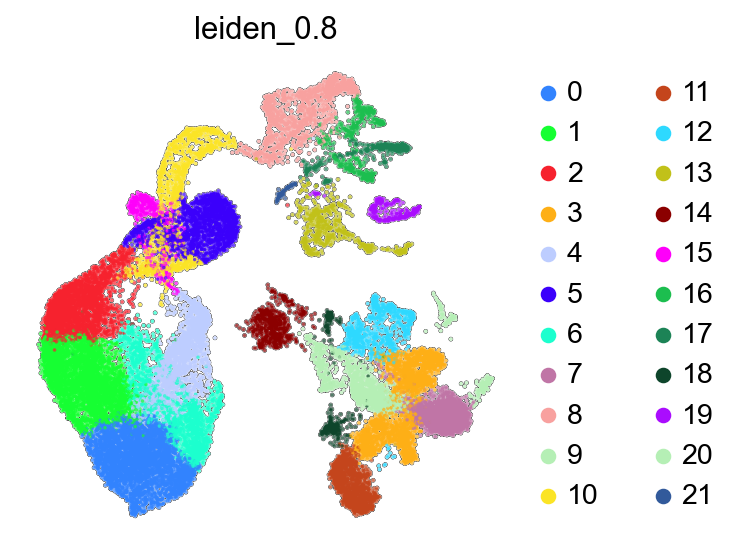

In [15]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    adata, 
    color=['leiden_0.8'], 
    use_raw=False,
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    ncols=5,
    wspace = 0.1,
    outline_width=[0.1, 0.05],
    size=10,
    frameon=False,
    add_outline=True,
    sort_order = False,
#         save="_adata_leiden_0_8"
)

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


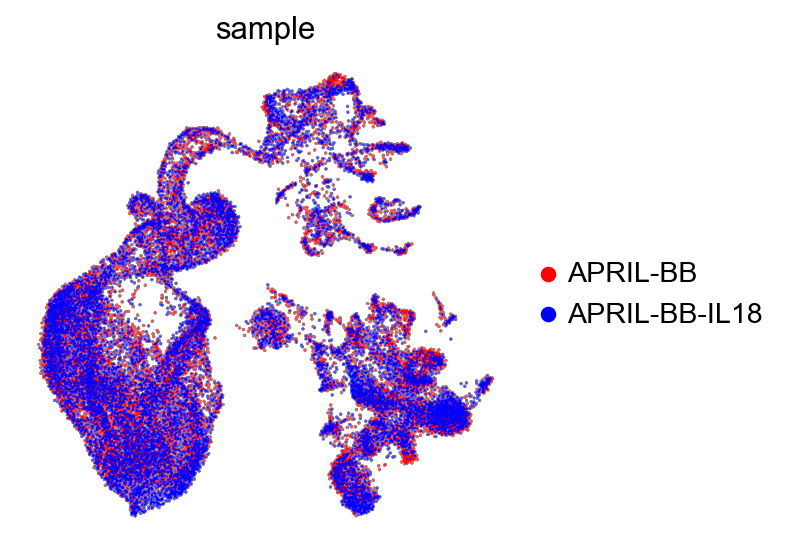

In [42]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='coolwarm', vector_friendly=True, transparent=True)
sc.pl.umap(
    adata,
    color='sample',
    use_raw=False,
    palette=['red', 'blue'],  
    color_map='coolwarm', 
    ncols=5,
    wspace = 0.1,
    outline_width=[0.1, 0.05],
    size=5,
    frameon=False,
    add_outline=True,
    sort_order = False,
#         save="_adata_APRIL_BB_IL18"
)

In [43]:
adata.obs['sample+hash'] = ''
adata.obs['sample+hash'] = adata.obs[['sample', 'hash_id']].agg('_'.join, axis=1)

In [16]:
adata2 = adata

ranking genes


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:418: RuntimeWarning: overflow encountered in expm1
  self.expm1_func(mean_rest) + 1e-9
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: invalid value encountered in divide
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/tools/_rank_gene

    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:02:46)


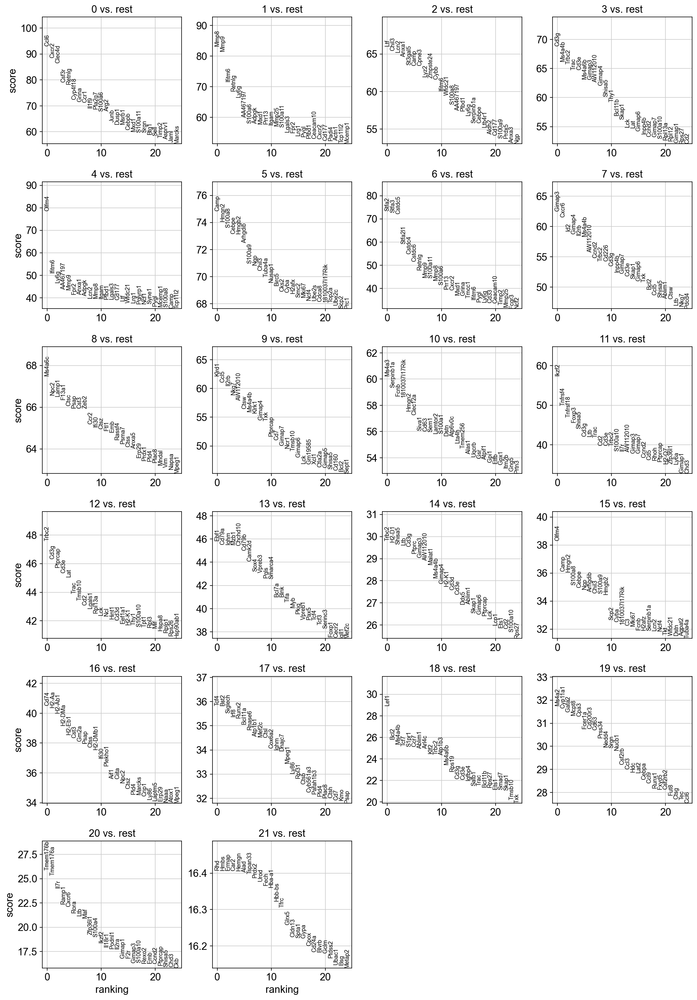

In [18]:
sc.tl.rank_genes_groups(adata, 'leiden_0.8', method='wilcoxon', use_raw=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [27]:
progenitor_genes = ['Cd34', 'Ly6a', 'Kit', 'Ly6c1', 'Flt3', 'Csf1r', 'Cd33', 'Ccr3']

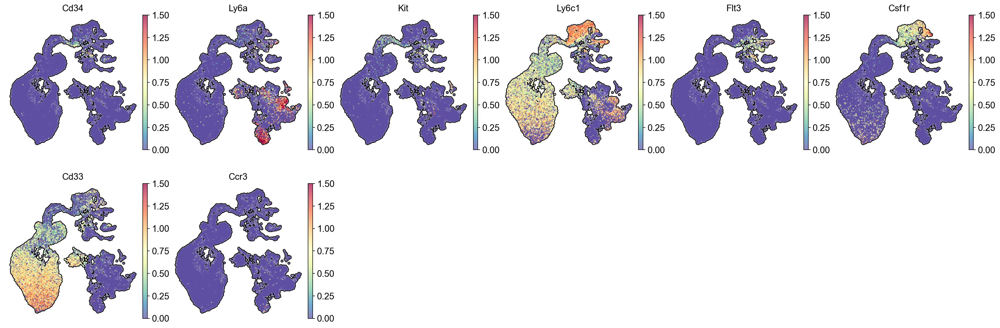

In [28]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color=progenitor_genes, 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=6,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False,
    vmax=1.5
)

<a id='basicgraphs'></a>

## Inspect basic data visualization

This part explores options for data visualization for canonical marker genes, differentially expressed genes and other genes of interest. We provide here four commonly used plots to observe gene expression and population frequencies in single cell data. For more visualization optios, please see scanpy's `Core plotting functions` tutorial (https://scanpy-tutorials.readthedocs.io/en/latest/plotting/core.html).

✍️ To start plotting, first save your genes of interest in a list, named here `marker_genes`. In the example below we use an extended list of canonical markers for the PBMC dataset in an effort to identify the identity of our clusters.

❗ Interogate markers of interest (if known), otherwise skip to the DEG section to identify marker genes for your unknown clusters.

In [29]:
marker_genes = ['Ptprc', 'Cd3e', 'Cxcr6', 'Cd4', 'Cd8a', 'Foxp3', 'Sdc1', 'Itgam', 'Ly6c1', 'Ly6g', 'Adgre1', 'Cd68', 'Mertk', 'Itgax', 'Zbtb46', 'Flt3', 'Cd19', 'Ncr1', 'Itga2', 'Csf1r']


💡 **Hint:** Individual gene names need to be in quotes and separated by commas as shown below. These are also case and name sensitive, so if you are working with mouse, human or other assemblies make sure you use the appropriate format.

### Create group annotation

❗ All plotting functions require a grouping factor to divide the data by. Choose from existing metadata, or create new metadata on your own.

We want to create a new annotation called `cell_type`. For that, we first need to identify what populations we have in our samples. Thus, we use a curated gene list (the one defined above) to inspect the expression of these genes in our data. 

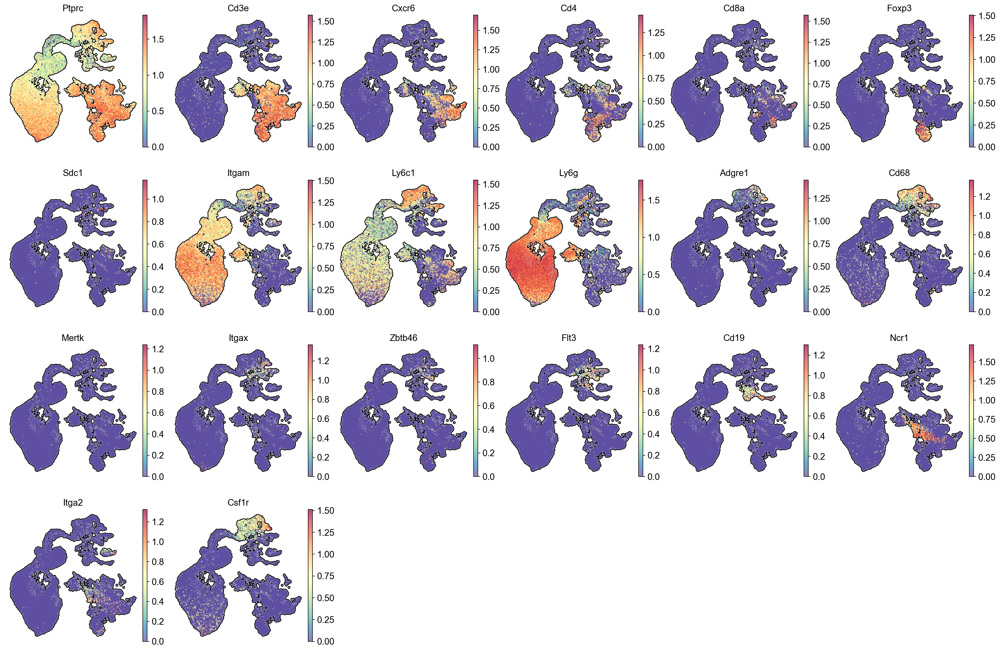

In [30]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color=marker_genes, 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=6,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False,
#     vmax=1.5
)

In [83]:
# to get top genes in each cluster
# to get gene list for defining unclear clusters (first need to run sc.tl wilcox)
sc.tl.rank_genes_groups(adata, 'leiden_0.8', method='wilcoxon', use_raw=False)
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names']}).head(100)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:54)


/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/s

,0_n,1_n,2_n,3_n,4_n,5_n,6_n,7_n,8_n,9_n,...,12_n,13_n,14_n,15_n,16_n,17_n,18_n,19_n,20_n,21_n
0,S100a11,Ifitm6,Lcn2,Cd3g,Olfm4,Hmgn2,Stfa3,Id2,Ms4a6c,Klrd1,...,Ran,Ebf1,Trbc2,Hmgn2,Cd74,Tcf4,Lef1,Cd63,Tmem176b,Rhd
1,Msrb1,Ly6g,Ltf,Tpt1,Ifitm6,Hmgb2,Stfa2,Gimap3,F13a1,Nkg7,...,Ppia,Chchd10,AW112010,Olfm4,H2-Aa,Bst2,Tpt1,Ms4a2,Tmem176a,Car2
2,Cxcr2,Mmp8,Lyz2,B2m,Anxa1,Camp,Cstdc5,Gimap4,Lamp1,Ccl5,...,Hint1,Cd79a,Gimap3,Camp,H2-Ab1,Irf8,Klf2,Cyp11a1,Il7r,Ermap
3,Ccl6,Mmp9,Camp,Ms4a6b,Ly6g,Nusap1,Stfa2l1,Cxcr6,Ctsc,Il2rb,...,Ptma,Mzb1,Cd3g,Chil3,H2-DMa,Siglech,Atp1b3,Gata2,Ramp1,Prdx2
4,Csf3r,Adpgk,Anxa1,Fau,AA467197,Cebpe,Cstdc4,Ms4a4b,Cst3,AW112010,...,Rbm3,Ighm,Ms4a4b,Hmgb2,Cst3,Bcl11a,Bcl2,Mcpt8,Cxcr6,Hmbs
5,Txn1,AA467197,Chil3,Ms4a4b,S100a8,Birc5,Cstdc6,Il2rb,Ifi30,Ctsw,...,Ncl,Pgls,Gimap4,Cebpe,H2-Eb1,Runx2,Ms4a4b,Cpa3,Ltb,Alad
6,S100a6,Anxa1,Cybb,Trbc2,Lcn2,Ube2c,Retnlg,AW112010,Rassf4,Klrk1,...,Tubb5,Cd79b,Ablim1,Ngp,Psap,Mef2c,Ablim1,Fcer1a,Rora,Tspan33
7,Retnlg,Pglyrp1,Cpne3,H2-K1,Adpgk,H2afx,S100a11,Ccnd2,Zeb2,Txk,...,Snrpf,Camk2d,Lck,Fcnb,Gm2a,Rnase6,Arl4c,Cd200r3,Maf,Hemgn
8,Clec4d,Itgam,Zmpste24,Cd3e,Wfdc21,Chil3,Mmp9,Tmsb10,Gpx1,Ms4a4b,...,Snrpe,Sox4,Skap1,Mki67,H2-DMb1,Ctsl,Tcf7,Prss34,S100a4,Glrx5
9,Grina,Cd177,St3gal5,Eef1a1,Pglyrp1,Top2a,Mmp8,Gm42418,Psap,Tmsb10,...,Snrpg,Vpreb3,Cd2,Orm1,Ifi30,Atp1b1,Ms4a6b,Nedd4,Emb,Metap2


Based on these canonical markers we can go ahead and rename our leiden clusters into the appropriate cell type, creating a new annotation field `cell_type`. We can then use this field for data visualization and other downstream analysis.

In [16]:
# using exact match
adata.obs['cell_type'] = ['B cells' if x=='13' else 
                          'NK cells' if x=='9' else
                          'T cells' if x =='3' or x=='7' or x=='12' or x=='14' or x=='18' or x=='20' else
                          'T regs' if x=='11' else
                          'Mac_mono' if x=='8' else
                          'DCs' if x=='16' else
                          'pDCs' if x=='17' else
                          'mast cells' if x=='19' else
                          'erythrocytes' if x=='21' else
                          'granulocytic cells' if x=='0' or x=='1' or x=='2' or x=='4' or x=='5' or x=='6' or x=='10'
                          or x=='15'
                          else 'ERROR' for x in adata.obs['leiden_0.8']]

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


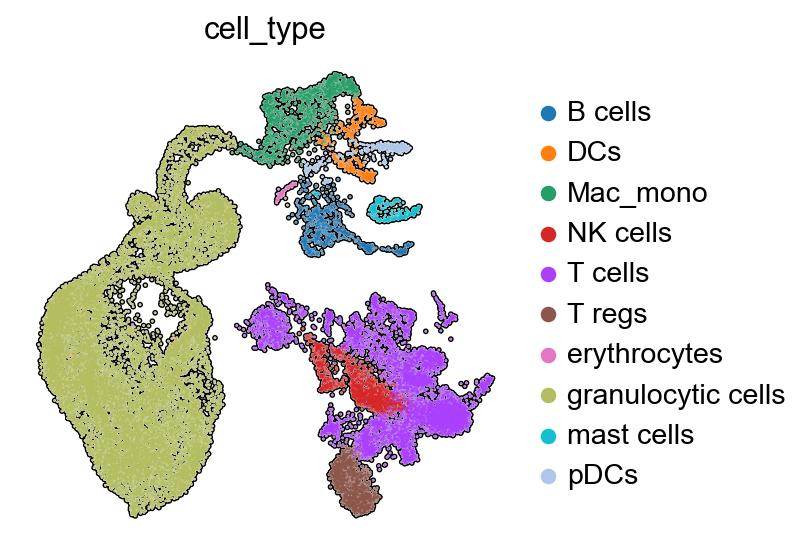

In [17]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='nipy_spectral', vector_friendly=False, transparent=True)
sc.pl.umap(
    adata, 
    color=['cell_type'], 
#     palette=user_defined_palette,  
    color_map='nipy_spectral', 
    use_raw=False,
    ncols=5,
    wspace = 0.1,
    outline_width=[0.6, 0.05],
    size=5,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [18]:
#to add group data
adata.obs['distinct'] = ''
adata.obs['distinct'] = adata.obs[['sample', 'hash_id']].agg(' '.join, axis=1)

### Explore visualization plots

In the examples below we are using the `cell_type` as the `groupby` parameter for plotting purposes. This can be replaced by any other grouping factor that has been applied in the data. See `section 4.1` on how to create a grouping factor.

#### Stacked barplots

We can take advantage of pandas crosstab function to format our data for a barplot. We need to grouping factors (the order matters!) to create this type of frequencies table, prior to making a barplot using python's matplotlib package.

In [21]:
crosstb = pd.crosstab(adata.obs['distinct'], adata.obs['cell_type'], normalize='index')

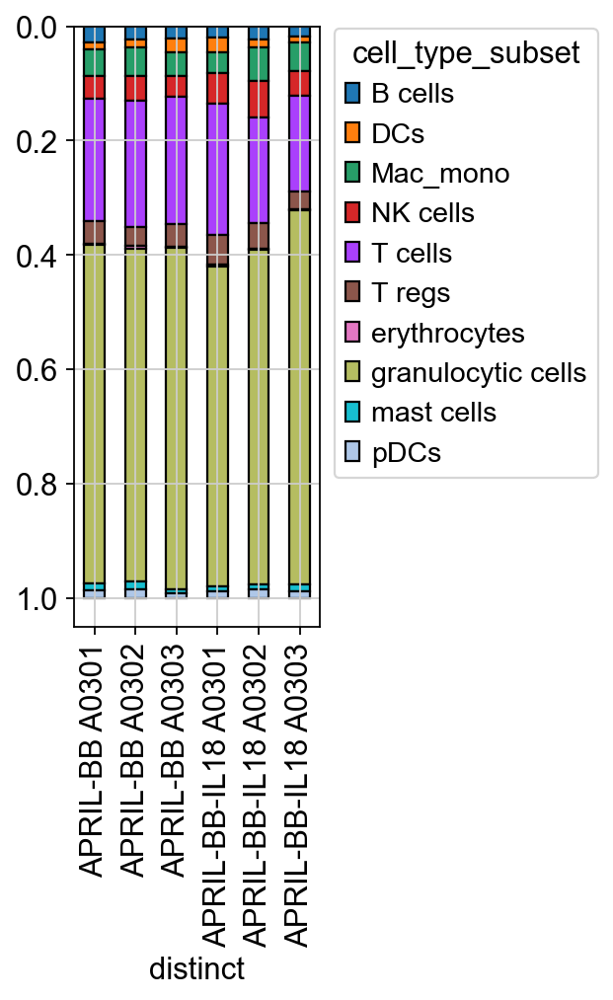

In [29]:
plt.rcParams['figure.figsize'] = [2, 5]

ax = crosstb.plot(kind='bar', stacked=True,  edgecolor = "black", color=adata.uns['cell_type_colors'])
ax.invert_yaxis()
ax.legend(title='cell_type_subset', bbox_to_anchor=(1, 1.02), loc='upper left')
plt.savefig('barplot_cell_type_distinct.pdf')

# bbox_inches = 'tight'

<a id='DEA'></a>

## Apply differential expression analysis (DEA)

We use the wilcoxon test here to perform differential expression analysis between our defined cell types. This can verify the identity of the annotated populations and also identify novel canonical marker genes. 

✍️ The test can be used for any type of comparison provided that you give it the right grouping factor.

### Wilcoxon test

Use pandas `ExcelWriter` function (https://pandas.pydata.org/docs/reference/api/pandas.ExcelWriter.html) to save the results to a file in the directory of your choice. Here, we name our file `shunPykeR_wilcox.xlsx` and the path leading to the directory is `../output/`.

💡 The `..` denotes a level up from the current directory.

In [22]:
writer = pd.ExcelWriter('../2022-12-21 APRIL BB IL-18 single cell experiment/wilcox_distinct/adata_total_wilcox.xlsx', engine='xlsxwriter')

sc.tl.rank_genes_groups(adata, 'sample', method='wilcoxon', use_raw=False)
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'scores', 'logfoldchanges', 'pvals_adj']}).to_excel(writer, sheet_name='all cells')
        
writer.close()

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:56)


## Integration with other types of scOMICs data

Oftentimes, scRNA-seq data need to be integrated with other formats of OMICs data. Here we explore some of these options.

### Integration with CITE-seq data

In [15]:
# add hashtag annotation
cite_APRIL_BB = sc.read_h5ad("../2022-12-21 APRIL BB IL-18 single cell experiment/data/internal/10xGenomics/Chromium/BN-2099_group1_CITE/CiteSeq-results/BN-2099_group1.h5ad")
cite_APRIL_BB_IL18 = sc.read_h5ad("../2022-12-21 APRIL BB IL-18 single cell experiment/data/internal/10xGenomics/Chromium/BN-2099_group2_CITE/CiteSeq-results/BN-2099_group2.h5ad")

In [16]:
cite_APRIL_BB.obs.index = cite_APRIL_BB.obs['barcode_sequence']
cite_APRIL_BB_IL18.obs.index = cite_APRIL_BB_IL18.obs['barcode_sequence']

In [17]:
cite_APRIL_BB.obs.index.name = ''
cite_APRIL_BB_IL18.obs.index.name = ''

In [18]:
cite_APRIL_BB.var.index = cite_APRIL_BB.var['feature_name'].values
cite_APRIL_BB_IL18.var.index = cite_APRIL_BB_IL18.var['feature_name'].values

In [19]:
cites = sc.concat(
    [cite_APRIL_BB, cite_APRIL_BB_IL18], # the asterisk unpacks the list containing your AnnData objects. 
    join='outer', 
    label = 'status', 
    keys = ['APRIL-BB', 'APRIL-BB-IL18'], # or use your sample_names list (as used above) here. 
    # Make sure the order of the batch categories matches that of the AnnData objects 
    index_unique = '-1@'
)

In [20]:
cites

AnnData object with n_obs × n_vars = 42307 × 129
    obs: 'unmapped', 'barcode_sequence', 'status'

In [21]:
cites.var['control']= cites.var_names.str.contains('isotype')

In [22]:
sc.pp.calculate_qc_metrics(
    cites, 
    percent_top=(5,10,15),
    var_type='antibodies',
    qc_vars=('control',),
    inplace=True)

In [23]:
cites.layers['counts']=cites.X.copy()

In [24]:
sc.pp.normalize_total(cites)

normalizing counts per cell
    finished (0:00:00)


In [25]:
rng = np.random.RandomState(42) # set seed 
sc.tl.pca(cites, n_comps=50,  svd_solver='arpack')
sc.pp.neighbors(cites, n_neighbors=15, random_state=42) # set seed
sc.tl.umap(cites)
sc.tl.leiden(cites, random_state=42, key_added='prot_leiden')

computing PCA
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)
running Leiden clustering
    finished: found 25 clusters and added
    'prot_leiden', the cluster labels (adata.obs, categorical) (0:00:09)


In [26]:
cites.obsp['protein_connectivities'] = cites.obsp['connectivities'].copy()

In [27]:
sc.tl.umap(cites)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:28)


In [28]:
cites.var['feature_name'] =cites.var_names

In [29]:
cites.var.index=cites.var['feature_name']

In [30]:
cites.obs["hash_id"]=adata.obs["hash_id"]

In [31]:
cites.var.index[:129]

Index(['anti-mouse CD4', 'anti-mouse CD8a', 'anti-mouse CD366 (Tim-3)',
       'anti-mouse CD279 (PD-1)', 'anti-mouse Ly-6C', 'anti-mouse/human CD11b',
       'anti-mouse Ly-6G', 'anti-human/mouse CD49f', 'anti-mouse/human CD44',
       'anti-mouse CD54',
       ...
       'anti-mouse CD159a (NKG2AB6)', 'anti-mouse Ly108', 'anti-mouse CD160',
       'anti-mouse CD85k (gp49 Receptor)', 'anti-mouse CD51',
       'anti-mouse CD94', 'anti-mouse CD205 (DEC-205)',
       'anti-mouse CD155 (PVR)', 'anti-mouse/rat CD81', 'anti-mouse CD45.1'],
      dtype='object', name='feature_name', length=129)

In [32]:
cites

AnnData object with n_obs × n_vars = 42307 × 129
    obs: 'unmapped', 'barcode_sequence', 'status', 'n_antibodies_by_counts', 'log1p_n_antibodies_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_5_antibodies', 'pct_counts_in_top_10_antibodies', 'pct_counts_in_top_15_antibodies', 'total_counts_control', 'log1p_total_counts_control', 'pct_counts_control', 'prot_leiden', 'hash_id'
    var: 'control', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'feature_name'
    uns: 'pca', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities', 'protein_connectivities'

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8

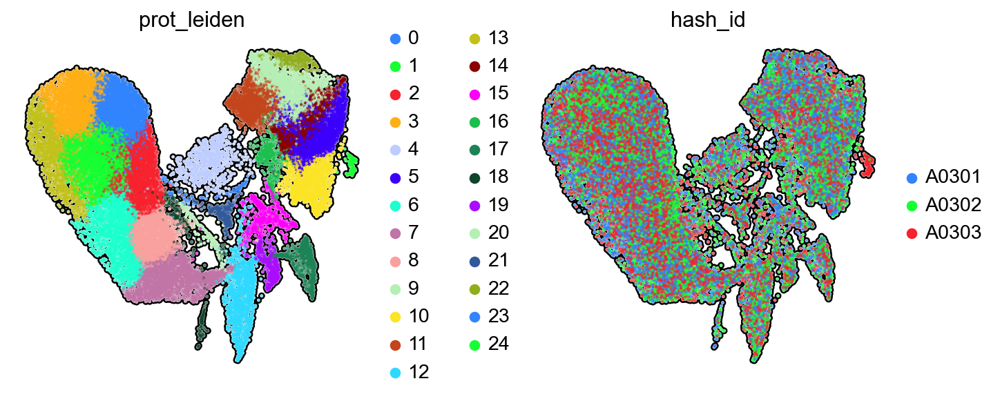

In [90]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=True, transparent=True)
sc.pl.umap(
    cites, 
    color=['prot_leiden', 'hash_id'], vmax=500, 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/Users/brandonng/opt/anaconda3/envs/updated_BDN_MM_IL18/lib/python3.8

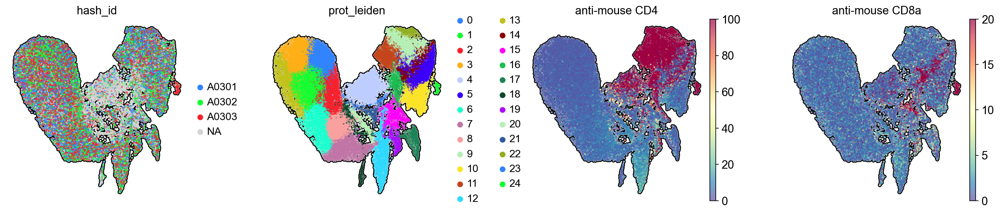

In [72]:
sc.set_figure_params(dpi=80, dpi_save=300, color_map='viridis', vector_friendly=False, transparent=True)
sc.pl.umap(
    cites, 
    color=['hash_id','prot_leiden','anti-mouse CD4', 'anti-mouse CD8a'], vmax=[0,0,100,20], 
    palette=user_defined_palette,  
    color_map='Spectral_r', 
    use_raw=False,
    ncols=5,
    wspace = 0.3,
    outline_width=[0.6, 0.05],
    size=15,
    frameon=False,
    add_outline=True,
    sort_order = False
)

In [33]:
del adata.obs['doublet_score']
del adata.obs['predicted_doublet']

In [34]:
mu.set_options(display_style="html", display_html_expand=0b000);

In [35]:
import muon as mu
from muon import MuData
from muon import prot as pt

In [35]:
# cites_to_h5ad =  '/Users/brandonng/Google Drive/Weill Cornell/LAB/folder containing all data from Mac pro/experiments and data/single cell/2022-12-21 APRIL BB IL-18 single cell experiment/20230508_MM_IL-18_singlecell_cites.h5ad'

In [37]:
# # code to read back your saved h5ad object
# cites = sc.read_h5ad(cites_to_h5ad)
# cites.uns['log1p']["base"] = None

In [36]:
mdata = MuData({"rna": adata, "prot": cites})

In [37]:
# we can use existing code to call cell types (based on leiden), then create new Muobject named that specific cell type

In [38]:
mdata.update_var()


In [39]:
mdata.update_obs()


In [40]:
mu.pp.intersect_obs(mdata)


In [132]:
mdata

rna:sample,category,"APRIL-BB,APRIL-BB,APRIL-BB,APRIL-BB,APRIL-BB,..."
rna:n_genes_by_counts,int32,"1486,1948,2079,4020,1377,1203,1987,3346,3251,1901,..."
rna:log1p_n_genes_by_counts,float64,"7.30,7.58,7.64,8.30,7.23,7.09,7.59,8.12,8.09,7.55,..."
rna:total_counts,float32,"6219.00,5201.00,10400.00,18790.00,6381.00,2728.00,..."
rna:log1p_total_counts,float32,"8.74,8.56,9.25,9.84,8.76,7.91,9.41,9.92,9.06,8.62,..."
rna:pct_counts_in_top_50_genes,float64,"60.89,31.15,60.96,28.02,62.56,33.21,66.80,59.27,..."
rna:pct_counts_in_top_100_genes,float64,"66.83,45.32,66.57,40.10,68.48,46.00,71.37,63.57,..."
rna:pct_counts_in_top_200_genes,float64,"72.99,55.82,72.49,52.03,75.02,57.81,77.15,69.05,..."
rna:pct_counts_in_top_500_genes,float64,"83.71,69.72,81.67,66.05,85.79,74.23,85.36,77.83,..."
rna:original_total_counts,float32,"6219.00,5201.00,10400.00,18790.00,6381.00,2728.00,..."
rna:log10_original_total_counts,float32,"3.79,3.72,4.02,4.27,3.80,3.44,4.09,4.31,3.93,3.74,..."


In [133]:
cites.var

,control,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,feature_name
feature_name,,,,,,,,
anti-mouse CD4,False,41192,69.717375,4.258691,2.635498,2949533,14.897158,anti-mouse CD4
anti-mouse CD8a,False,33697,12.997518,2.638880,20.351242,549886,13.217468,anti-mouse CD8a
anti-mouse CD366 (Tim-3),False,40835,8.660458,2.268041,3.479330,366398,12.811478,anti-mouse CD366 (Tim-3)
anti-mouse CD279 (PD-1),False,40962,11.214504,2.502624,3.179143,474452,13.069918,anti-mouse CD279 (PD-1)
anti-mouse Ly-6C,False,42303,325.574964,5.788660,0.009455,13774100,16.438301,anti-mouse Ly-6C
anti-mouse/human CD11b,False,42300,717.885244,6.577702,0.016546,30371571,17.229018,anti-mouse/human CD11b
anti-mouse Ly-6G,False,42300,969.018862,6.877316,0.016546,40996281,17.528992,anti-mouse Ly-6G
anti-human/mouse CD49f,False,42287,63.175243,4.161618,0.047274,2672755,14.798621,anti-human/mouse CD49f
anti-mouse/human CD44,False,42305,650.980972,6.480015,0.004727,27541052,17.131188,anti-mouse/human CD44


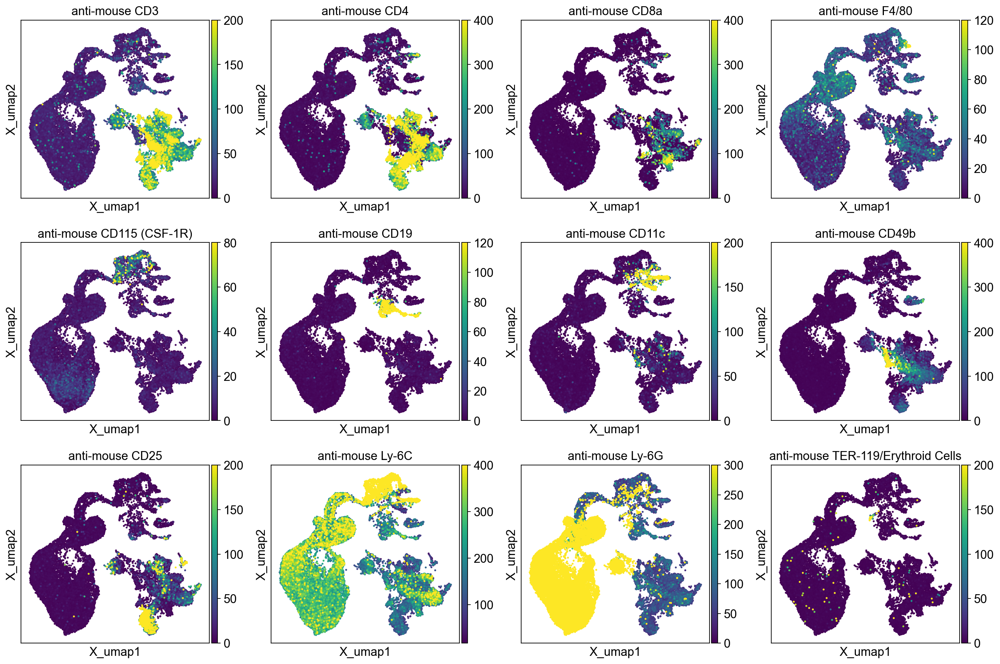

In [123]:
mu.pl.embedding(mdata, basis="rna:X_umap",
                color=['anti-mouse CD3', 'anti-mouse CD4', 'anti-mouse CD8a', 'anti-mouse F4/80',  'anti-mouse CD115 (CSF-1R)',
                       'anti-mouse CD19', 'anti-mouse CD11c', 'anti-mouse CD49b', 'anti-mouse CD25',
                      'anti-mouse Ly-6C', 'anti-mouse Ly-6G', 'anti-mouse TER-119/Erythroid Cells'
                      ],
                use_raw=False,
                cmap='viridis',
                vmax=[200, 400, 400, 120, 80, 120, 200, 400, 200, 400, 300, 200],
                size=20,
               save="_lineage_markers_CITE.pdf"
               )


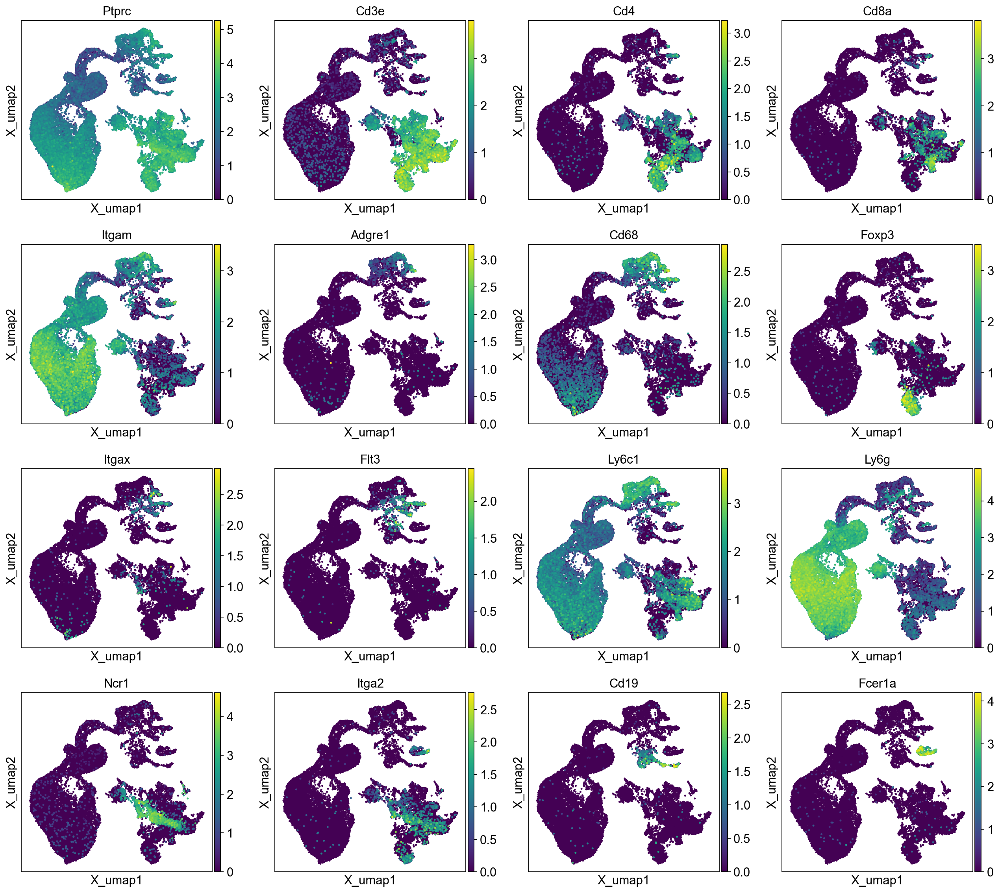

In [140]:
mu.pl.embedding(mdata, basis="rna:X_umap",
                color=['Ptprc', 'Cd3e', 'Cd4', 'Cd8a',
                       'Itgam', 'Adgre1', 'Cd68', 'Foxp3', 'Itgax', 'Flt3', 'Ly6c1', 'Ly6g',
                       'Ncr1', 'Itga2', 'Cd19', 'Fcer1a'],
#                vmax=5,
                use_raw=False,
                size=20,
#                 save="_RNA_lineage_markers.pdf"
               )


## System log

Date, time stamps, version numbers, and hardware information for version control.

In [103]:
%load_ext watermark

In [104]:
%watermark

Last updated: 2023-01-06T18:48:23.034947+00:00

Python implementation: CPython
Python version       : 3.8.13
IPython version      : 8.4.0

Compiler    : Clang 12.0.0 
OS          : Darwin
Release     : 20.6.0
Machine     : x86_64
Processor   : i386
CPU cores   : 8
Architecture: 64bit

